<a href="https://colab.research.google.com/github/TAFIMnoor/Boat-saga.GAME/blob/master/Brightness_Enhancement.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

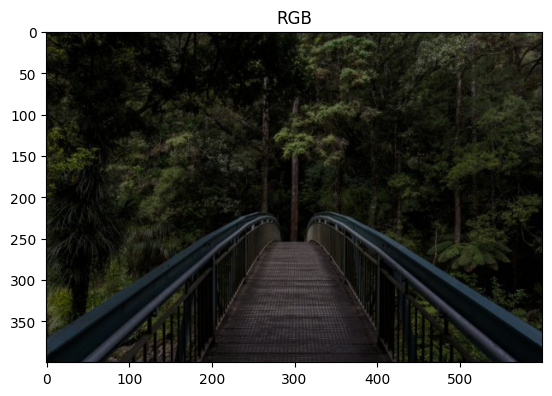

Dimmed Image


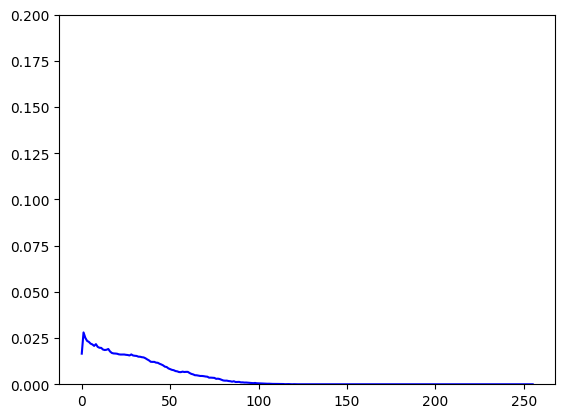

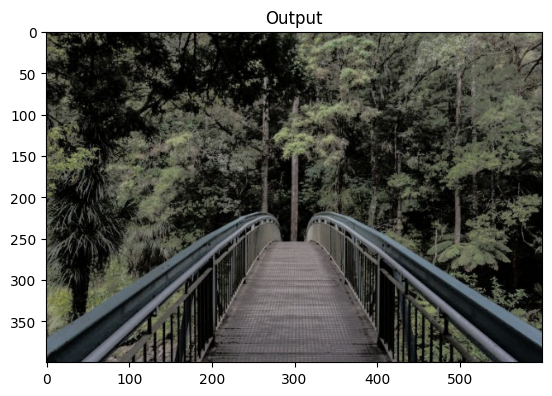

In [ ]:
#https://github.com/leowang7/iagcwd

%matplotlib inline

import cv2
import numpy as np
from matplotlib import pyplot as plt
from scipy.linalg import fractional_matrix_power

def image_agcwd(img, a=0.25):
    h,w = img.shape[:2]
    hist,bins = np.histogram(img.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf / cdf.max()
    prob_normalized = hist / hist.sum()

    unique_intensity = np.unique(img)
    intensity_max = unique_intensity.max()
    intensity_min = unique_intensity.min()
    prob_min = prob_normalized.min()
    prob_max = prob_normalized.max()

    pn_temp = (prob_normalized - prob_min) / (prob_max - prob_min)
    pn_temp[pn_temp>0] = prob_max * (pn_temp[pn_temp>0]**a)
    pn_temp[pn_temp<0] = prob_max * (-((-pn_temp[pn_temp<0])**a))
    prob_normalized_wd = pn_temp / pn_temp.sum() # normalize to [0,1]
    cdf_prob_normalized_wd = prob_normalized_wd.cumsum()
    inverse_cdf = 1 - cdf_prob_normalized_wd

    img_new = img.copy()
    for i in unique_intensity:
        img_new[img==i] = np.round(255 * (i / 255)**inverse_cdf[i])

#     print ("%f %f"%(prob_min, prob_max))
    plt.plot(inverse_cdf, color = 'b')
#     plt.plot(inverse_cdf, color = 'r')
#     plt.ylim([0,0.15])
    plt.show()

    return img_new

def image_agcwd_truncated(img, a=0.75):
    h,w = img.shape[:2]
    hist,bins = np.histogram(img.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf / cdf.max()
    prob_normalized = hist / hist.sum()

    unique_intensity = np.unique(img)
    intensity_max = unique_intensity.max()
    intensity_min = unique_intensity.min()
    prob_min = prob_normalized.min()
    prob_max = prob_normalized.max()

    pn_temp = (prob_normalized - prob_min) / (prob_max - prob_min)
    pn_temp[pn_temp>0] = prob_max * (pn_temp[pn_temp>0]**a)
    pn_temp[pn_temp<0] = prob_max * (-((-pn_temp[pn_temp<0])**a))
    prob_normalized_wd = pn_temp / pn_temp.sum() # normalize to [0,1]
    cdf_prob_normalized_wd = prob_normalized_wd.cumsum()
    inverse_cdf = np.maximum(0.5,1 - cdf_prob_normalized_wd)

    img_new = img.copy()
    for i in unique_intensity:
        img_new[img==i] = np.round(255 * (i / 255)**inverse_cdf[i])

#     print ("%f %f"%(prob_min, prob_max))
#     print (cdf_prob_normalized_wd.min(),cdf_prob_normalized_wd.max())
#     print(hist.sum(),h*w)
    plt.plot(prob_normalized_wd, color = 'b')
#     plt.plot(inverse_cdf, color = 'r')
    plt.ylim([0,0.2])
    plt.show()

    return img_new


def process_bright(img):
    img_negative = 255 - img
#     plt.imshow(img_negative, cmap='gray')
#     plt.title('Negative Image')
#     plt.show()

    agcwd = image_agcwd(img_negative)
    reversed = 255 - agcwd
    return reversed

def process_dimmed(img):
    agcwd = image_agcwd_truncated(img)
    return agcwd

# Read image
img = cv2.imread('/content/sample_data/lb3.jpeg',)
rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
YCrCb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
Y = YCrCb[:,:,0]
plt.imshow(rgb)
plt.title('RGB')
plt.show()
# plt.imshow(Y, cmap='gray')
# plt.title('Gray Scale')
# plt.show()

# Determine whether image is bright or dimmed
threshold = 0.3
T_t = 112 # Global average brightness
M,N = img.shape[:2]
m_I = np.sum(Y/(M*N))
t = (m_I - T_t)/ T_t

img_output = None
if t < -threshold:
    print ("Dimmed Image")
    result = process_dimmed(Y)
    YCrCb[:,:,0] = result
    img_output = cv2.cvtColor(YCrCb,cv2.COLOR_YCrCb2RGB)
    plt.imshow(img_output)
    plt.title('Output')
    plt.show()
elif t > threshold:
    print ("Bright Image")
    result = process_bright(Y)
    YCrCb[:,:,0] = result
    img_output = cv2.cvtColor(YCrCb,cv2.COLOR_YCrCb2RGB)
    plt.imshow(img_output)
    plt.title('Output')
    plt.show()
else:
    print("Could not Detect Image")



<ipython-input-1-a835e5910651>:15: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter
<ipython-input-1-a835e5910651>:165: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(img_name)
<ipython-input-1-a835e5910651>:180: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(img_name)
<ipython-input-1-a835e5910651>:194: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v

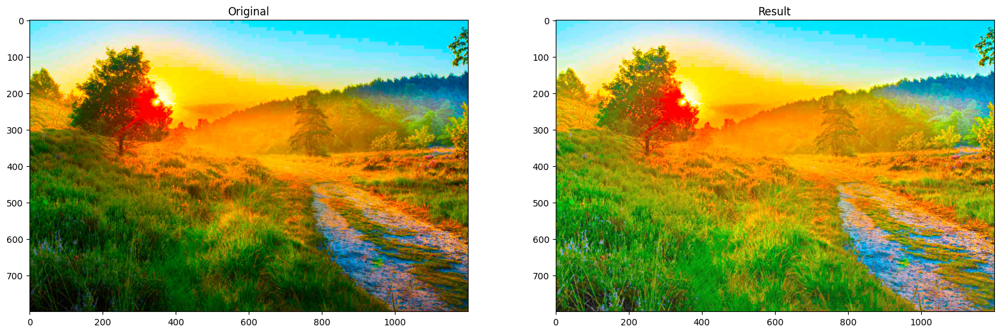

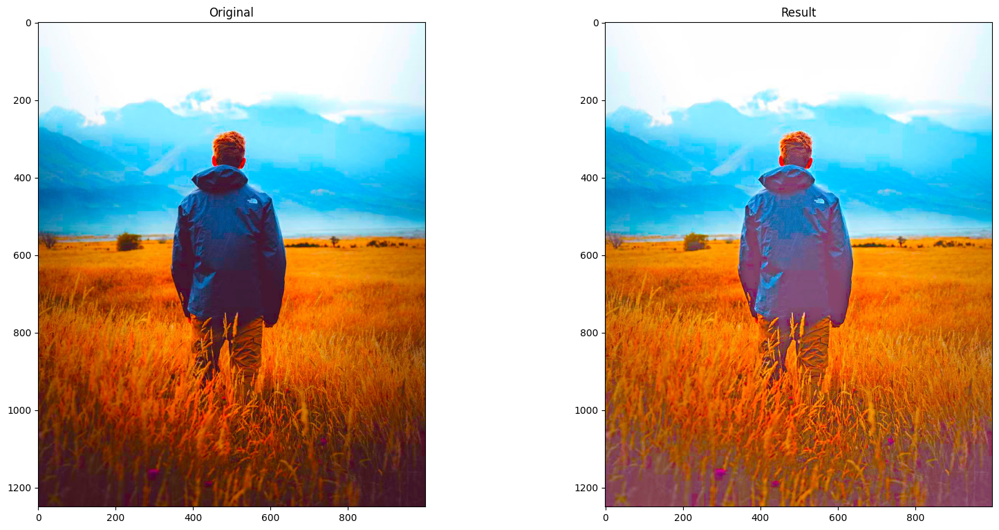

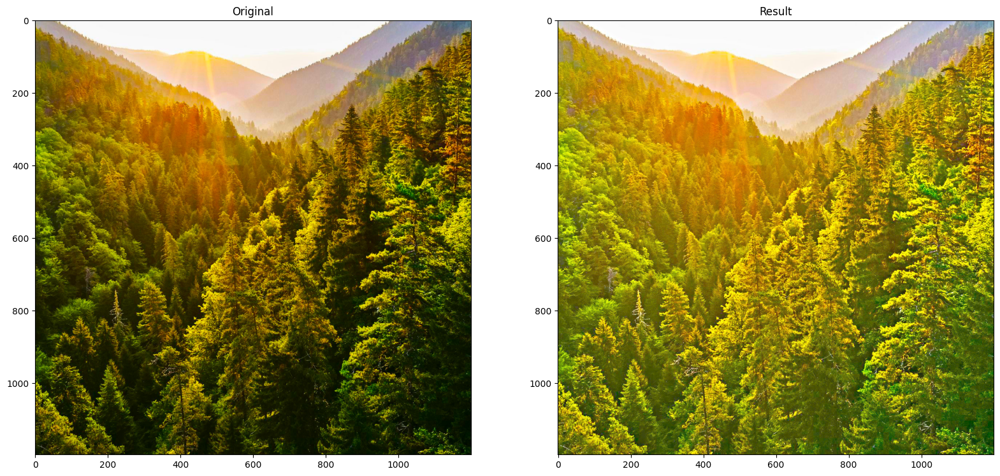

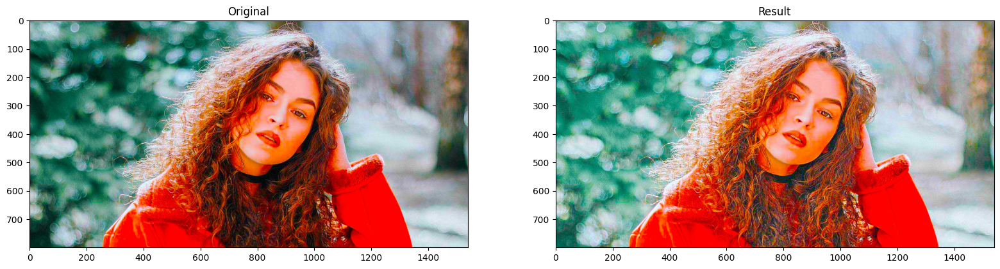

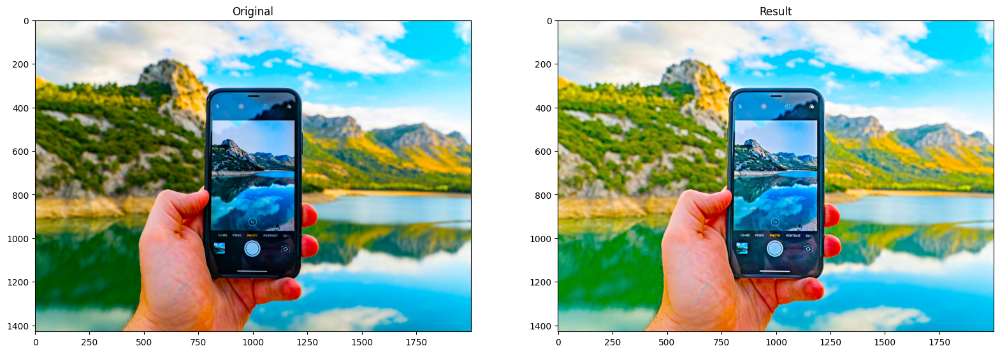

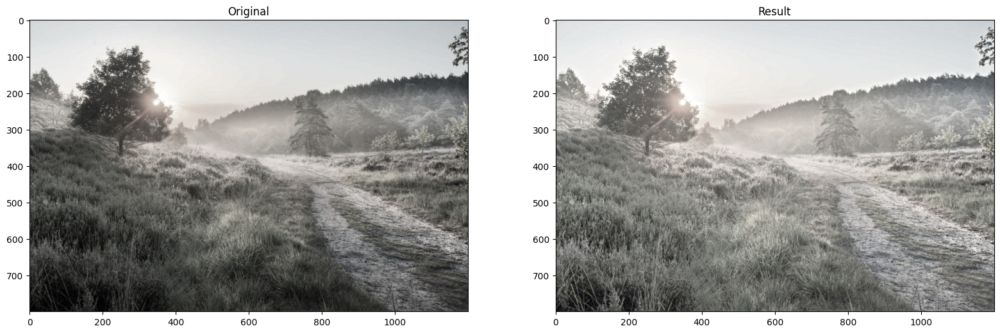

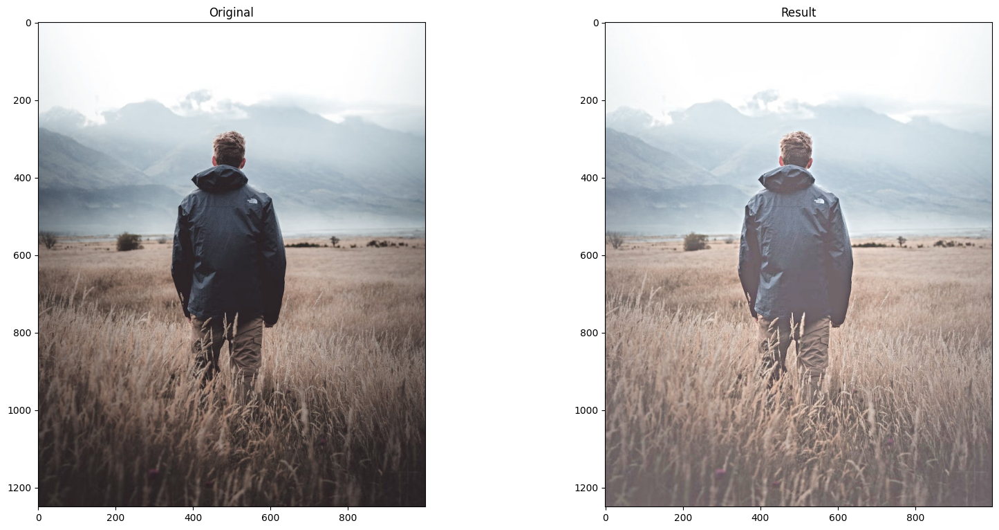

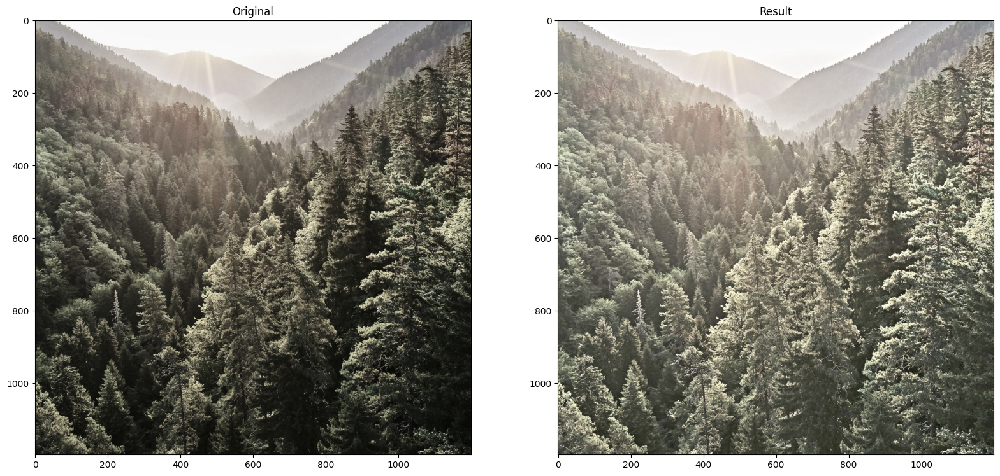

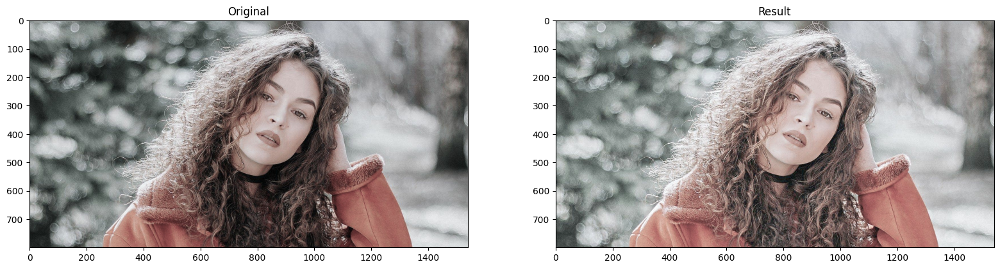

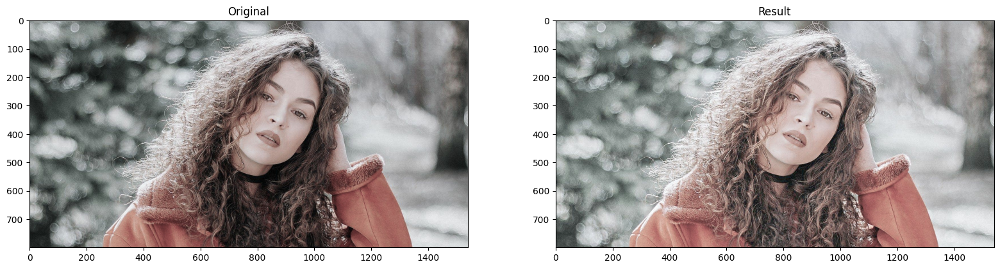

In [ ]:
#Image Contrast Enhancement Algorithm using Exposure Fusion Framework

#!pip install scipy==1.2.2

!pip install scipy

import numpy as np
import matplotlib.pyplot as plt
import imageio
import scipy, scipy.misc, scipy.signal, scipy.ndimage
import cv2
import sys
import skimage
from scipy.ndimage import zoom
from scipy.ndimage.filters import gaussian_filter


def computeTextureWeights(fin, sigma, sharpness):
    dt0_v = np.vstack((np.diff(fin, n=1, axis=0), fin[0,:]-fin[-1,:]))
    dt0_h = np.vstack((np.diff(fin, n=1, axis=1).conj().T, fin[:,0].conj().T-fin[:,-1].conj().T)).conj().T

    gauker_h = scipy.signal.convolve2d(dt0_h, np.ones((1,sigma)), mode='same')
    gauker_v = scipy.signal.convolve2d(dt0_v, np.ones((sigma,1)), mode='same')

    W_h = 1/(np.abs(gauker_h)*np.abs(dt0_h)+sharpness)
    W_v = 1/(np.abs(gauker_v)*np.abs(dt0_v)+sharpness)

    return  W_h, W_v

def solveLinearEquation(IN, wx, wy, lamda):
    [r, c] = IN.shape
    k = r * c
    dx =  -lamda * wx.flatten('F')
    dy =  -lamda * wy.flatten('F')
    tempx = np.roll(wx, 1, axis=1)
    tempy = np.roll(wy, 1, axis=0)
    dxa = -lamda *tempx.flatten('F')
    dya = -lamda *tempy.flatten('F')
    tmp = wx[:,-1]
    tempx = np.concatenate((tmp[:,None], np.zeros((r,c-1))), axis=1)
    tmp = wy[-1,:]
    tempy = np.concatenate((tmp[None,:], np.zeros((r-1,c))), axis=0)
    dxd1 = -lamda * tempx.flatten('F')
    dyd1 = -lamda * tempy.flatten('F')

    wx[:,-1] = 0
    wy[-1,:] = 0
    dxd2 = -lamda * wx.flatten('F')
    dyd2 = -lamda * wy.flatten('F')

    Ax = scipy.sparse.spdiags(np.concatenate((dxd1[:,None], dxd2[:,None]), axis=1).T, np.array([-k+r,-r]), k, k)
    Ay = scipy.sparse.spdiags(np.concatenate((dyd1[None,:], dyd2[None,:]), axis=0), np.array([-r+1,-1]), k, k)
    D = 1 - ( dx + dy + dxa + dya)
    A = ((Ax+Ay) + (Ax+Ay).conj().T + scipy.sparse.spdiags(D, 0, k, k)).T

    tin = IN[:,:]
    tout = scipy.sparse.linalg.spsolve(A, tin.flatten('F'))
    OUT = np.reshape(tout, (r, c), order='F')

    return OUT


def tsmooth(img, lamda=0.01, sigma=3.0, sharpness=0.001):
    I = cv2.normalize(img.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)
    x = np.copy(I)
    wx, wy = computeTextureWeights(x, sigma, sharpness)
    S = solveLinearEquation(I, wx, wy, lamda)
    return S

def rgb2gm(I):
    if (I.shape[2] == 3):
        I = cv2.normalize(I.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)
        I = np.abs((I[:,:,0]*I[:,:,1]*I[:,:,2]))**(1/3)

    return I

def applyK(I, k, a=-0.3293, b=1.1258):
    f = lambda x: np.exp((1-x**a)*b)
    beta = f(k)
    gamma = k**a
    J = (I**gamma)*beta
    return J

def entropy(X):
    tmp = X * 255
    tmp[tmp > 255] = 255
    tmp[tmp<0] = 0
    tmp = tmp.astype(np.uint8)
    _, counts = np.unique(tmp, return_counts=True)
    pk = np.asarray(counts)
    pk = 1.0*pk / np.sum(pk, axis=0)
    S = -np.sum(pk * np.log2(pk), axis=0)
    return S

def maxEntropyEnhance(I, isBad, a=-0.3293, b=1.1258):
    # Esatimate k
    tmp = cv2.resize(I, (50,50), interpolation=cv2.INTER_AREA)
    tmp[tmp<0] = 0
    tmp = tmp.real
    Y = rgb2gm(tmp)

    isBad = isBad * 1
    #isBad = scipy.misc.imresize(isBad, (50,50), interp='bicubic', mode='F')
    # Ensure the image is in float format
    isBad = isBad.astype(float)
    # Resize the image
    isBad = cv2.resize(isBad, (50, 50), interpolation=cv2.INTER_CUBIC)
    isBad[isBad<0.5] = 0
    isBad[isBad>=0.5] = 1
    Y = Y[isBad==1]

    if Y.size == 0:
       J = I
       return J

    f = lambda k: -entropy(applyK(Y, k))
    opt_k = scipy.optimize.fminbound(f, 1, 7)

    # Apply k
    J = applyK(I, opt_k, a, b) - 0.01
    return J


def Ying_2017_CAIP(img, mu=0.5, a=-0.3293, b=1.1258):
    lamda = 0.5
    sigma = 5
    I = cv2.normalize(img.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)

    # Weight matrix estimation
    t_b = np.max(I, axis=2)

    #t_our = cv2.resize(tsmooth(scipy.imresize(t_b, 0.5, interp='bicubic', mode='F'), lamda, sigma), (t_b.shape[1], t_b.shape[0]), interpolation=cv2.INTER_AREA)
    # Resize the image down by 50% using bicubic interpolation
    t_b_down = zoom(t_b, 0.5, order=3)

    # Apply the smoothing function
    t_smooth = gaussian_filter(t_b_down, sigma=sigma)

    # Resize the image back to original size using OpenCV (which uses bilinear interpolation by default)
    t_our = cv2.resize(t_smooth, (t_b.shape[1], t_b.shape[0]), interpolation=cv2.INTER_AREA)



    # Apply camera model with k(exposure ratio)
    isBad = t_our < 0.5
    J = maxEntropyEnhance(I, isBad)

    # W: Weight Matrix
    t = np.zeros((t_our.shape[0], t_our.shape[1], I.shape[2]))
    for i in range(I.shape[2]):
        t[:,:,i] = t_our
    W = t**mu

    I2 = I*W
    J2 = J*(1-W)

    result = I2 + J2
    result = result * 255
    result[result > 255] = 255
    result[result<0] = 0
    return result.astype(np.uint8)

def main():
    img_name = "/content/sample_data/hs.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/hs2.jpg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')

    img_name = "/content/sample_data/hs3.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/hs4.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')

    img_name = "/content/sample_data/hs5.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/ls.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/ls2.jpg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')



    img_name = "/content/sample_data/ls3.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/ls4.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')

    img_name = "/content/sample_data/ls4.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


if __name__ == '__main__':
    main()

<ipython-input-2-be5224344cec>:151: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(img_name)
/usr/local/lib/python3.10/dist-packages/scipy/sparse/linalg/_dsolve/linsolve.py:229: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  warn('spsolve requires A be CSC or CSR matrix format',
<ipython-input-2-be5224344cec>:72: RuntimeWarning: invalid value encountered in power
  J = (I**gamma)*beta
<ipython-input-2-be5224344cec>:166: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(img_name)
<ipython-input-2-be5224344cec>:180: Deprec

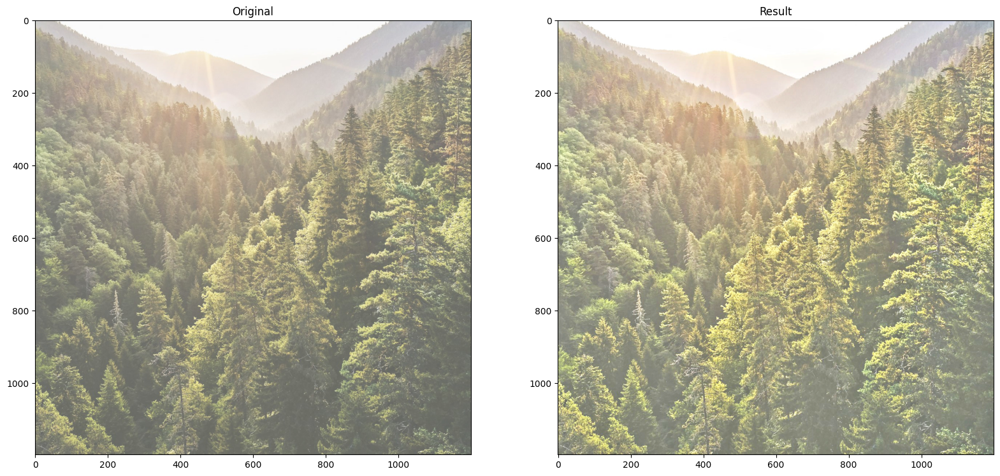

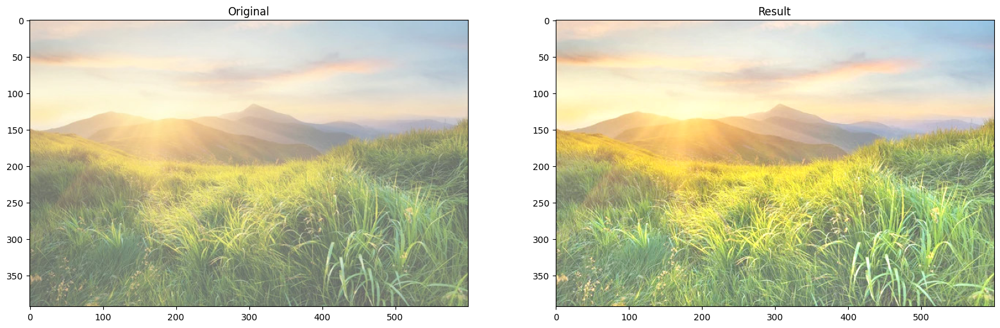

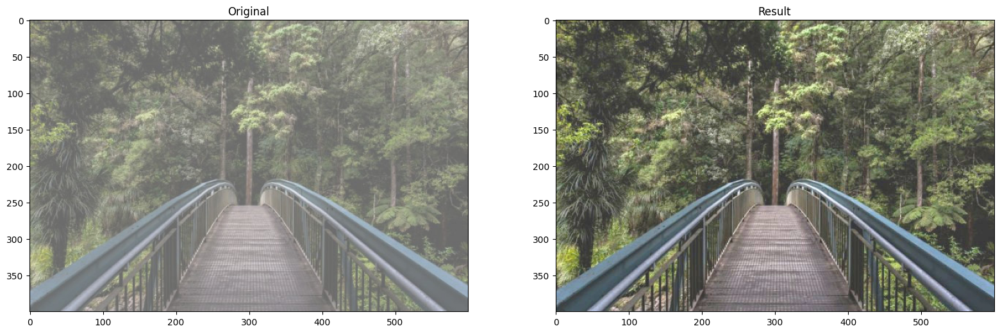

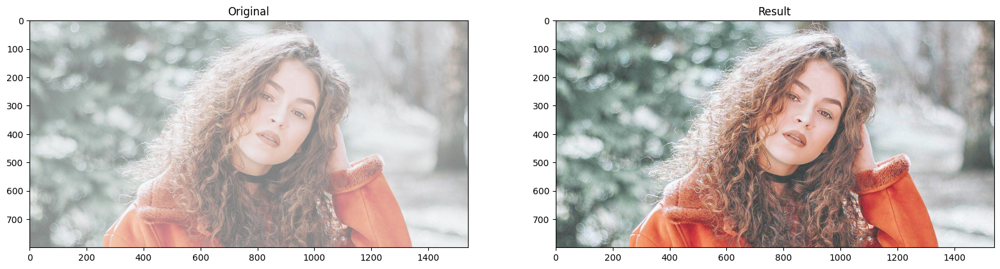

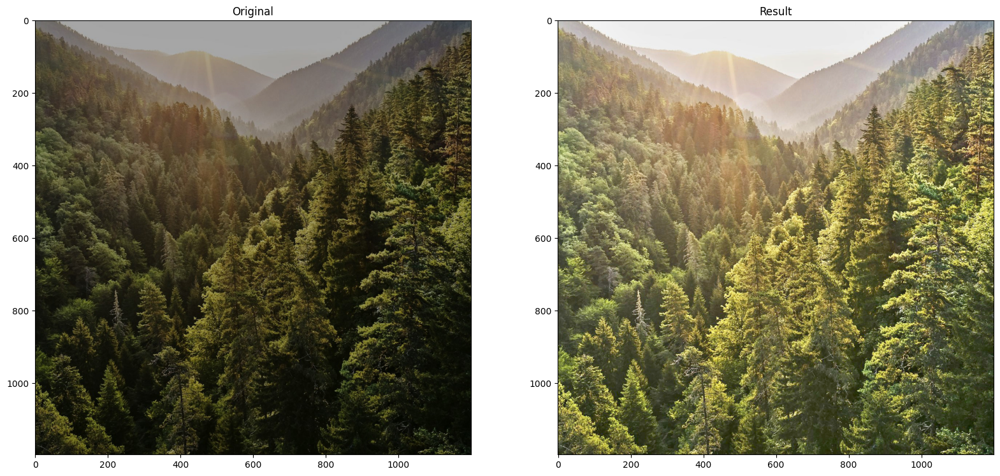

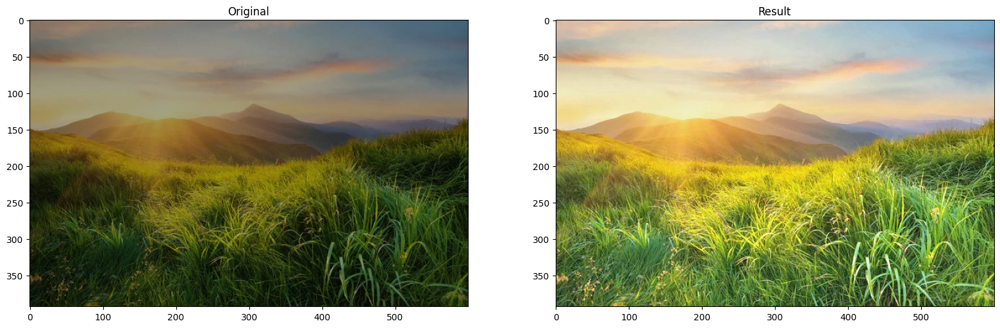

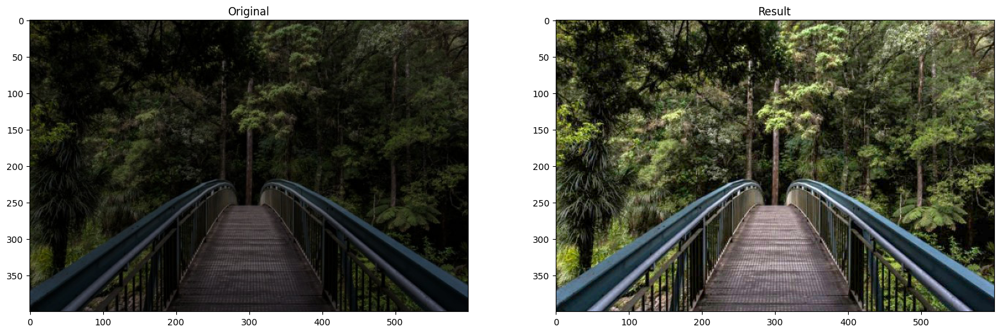

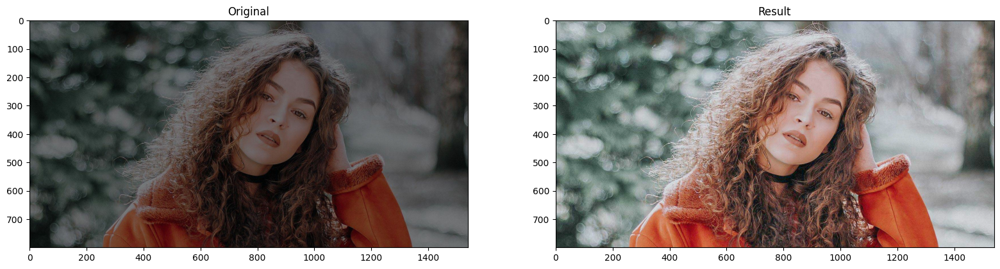

In [ ]:
# 2.0 : Image Contrast Enhancement Algorithm using Exposure Fusion Framework

import numpy as np
import imageio
import scipy, scipy.misc, scipy.signal
import cv2
import sys
from PIL import Image
import matplotlib.pyplot as plt

def computeTextureWeights(fin, sigma, sharpness):
    dt0_v = np.vstack((np.diff(fin, n=1, axis=0), fin[0,:]-fin[-1,:]))
    dt0_h = np.vstack((np.diff(fin, n=1, axis=1).conj().T, fin[:,0].conj().T-fin[:,-1].conj().T)).conj().T

    gauker_h = scipy.signal.convolve2d(dt0_h, np.ones((1,sigma)), mode='same')
    gauker_v = scipy.signal.convolve2d(dt0_v, np.ones((sigma,1)), mode='same')

    W_h = 1/(np.abs(gauker_h)*np.abs(dt0_h)+sharpness)
    W_v = 1/(np.abs(gauker_v)*np.abs(dt0_v)+sharpness)

    return  W_h, W_v

def solveLinearEquation(IN, wx, wy, lamda):
    [r, c] = IN.shape
    k = r * c
    dx =  -lamda * wx.flatten('F')
    dy =  -lamda * wy.flatten('F')
    tempx = np.roll(wx, 1, axis=1)
    tempy = np.roll(wy, 1, axis=0)
    dxa = -lamda *tempx.flatten('F')
    dya = -lamda *tempy.flatten('F')
    tmp = wx[:,-1]
    tempx = np.concatenate((tmp[:,None], np.zeros((r,c-1))), axis=1)
    tmp = wy[-1,:]
    tempy = np.concatenate((tmp[None,:], np.zeros((r-1,c))), axis=0)
    dxd1 = -lamda * tempx.flatten('F')
    dyd1 = -lamda * tempy.flatten('F')

    wx[:,-1] = 0
    wy[-1,:] = 0
    dxd2 = -lamda * wx.flatten('F')
    dyd2 = -lamda * wy.flatten('F')

    Ax = scipy.sparse.spdiags(np.concatenate((dxd1[:,None], dxd2[:,None]), axis=1).T, np.array([-k+r,-r]), k, k)
    Ay = scipy.sparse.spdiags(np.concatenate((dyd1[None,:], dyd2[None,:]), axis=0), np.array([-r+1,-1]), k, k)
    D = 1 - ( dx + dy + dxa + dya)
    A = ((Ax+Ay) + (Ax+Ay).conj().T + scipy.sparse.spdiags(D, 0, k, k)).T

    tin = IN[:,:]
    tout = scipy.sparse.linalg.spsolve(A, tin.flatten('F'))
    OUT = np.reshape(tout, (r, c), order='F')

    return OUT


def tsmooth(img, lamda=0.01, sigma=3.0, sharpness=0.001):
    I = cv2.normalize(img.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)
    x = np.copy(I)
    wx, wy = computeTextureWeights(x, sigma, sharpness)
    S = solveLinearEquation(I, wx, wy, lamda)
    return S

def rgb2gm(I):
    if (I.shape[2] == 3):
        I = cv2.normalize(I.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)
        I = np.abs((I[:,:,0]*I[:,:,1]*I[:,:,2]))**(1/3)

    return I

def applyK(I, k, a=-0.3293, b=1.1258):
    f = lambda x: np.exp((1-x**a)*b)
    beta = f(k)
    gamma = k**a
    J = (I**gamma)*beta
    return J

def entropy(X):
    tmp = X * 255
    tmp[tmp > 255] = 255
    tmp[tmp<0] = 0
    tmp = tmp.astype(np.uint8)
    _, counts = np.unique(tmp, return_counts=True)
    pk = np.asarray(counts)
    pk = 1.0*pk / np.sum(pk, axis=0)
    S = -np.sum(pk * np.log2(pk), axis=0)
    return S

def maxEntropyEnhance(I, isBad, a=-0.3293, b=1.1258):
    # Esatimate k
    tmp = cv2.resize(I, (50,50), interpolation=cv2.INTER_AREA)
    tmp[tmp<0] = 0
    tmp = tmp.real
    Y = rgb2gm(tmp)

    isBad = isBad * 1
    #isBad = scipy.misc.imresize(isBad, (50,50), interp='bicubic', mode='F')
    isBad = Image.fromarray(isBad.astype(np.float64))
    size = tuple((50,50))
    isBad = np.array(isBad.resize(size, Image.BICUBIC))
    isBad[isBad<0.5] = 0
    isBad[isBad>=0.5] = 1
    Y = Y[isBad==1]

    if Y.size == 0:
       J = I
       return J

    f = lambda k: -entropy(applyK(Y, k))
    opt_k = scipy.optimize.fminbound(f, 1, 7)

    # Apply k
    J = applyK(I, opt_k, a, b) - 0.01
    return J


def Ying_2017_CAIP(img, mu=0.5, a=-0.3293, b=1.1258):
    lamda = 0.5
    sigma = 5
    I = cv2.normalize(img.astype('float64'), None, 0.0, 1.0, cv2.NORM_MINMAX)

    # Weight matrix estimation
    t_b = np.max(I, axis=2)
    #t_our = cv2.resize(tsmooth(scipy.misc.imresize(t_b, 0.5, interp='bicubic', mode='F'), lamda, sigma), (t_b.shape[1], t_b.shape[0]), interpolation=cv2.INTER_AREA)




    t_b = Image.fromarray(t_b)
    size = tuple((np.array(t_b.size) * 0.5).astype(int))

    t_our = cv2.resize(tsmooth(np.array(t_b.resize(size, Image.BICUBIC)), lamda, sigma), (np.array(t_b).shape[1], np.array(t_b).shape[0]), interpolation=cv2.INTER_AREA)
    # Apply camera model with k(exposure ratio)
    isBad = t_our < 0.5
    J = maxEntropyEnhance(I, isBad)

    # W: Weight Matrix
    t = np.zeros((t_our.shape[0], t_our.shape[1], I.shape[2]))
    for i in range(I.shape[2]):
        t[:,:,i] = t_our
    W = t**mu

    I2 = I*W
    J2 = J*(1-W)

    result = I2 + J2
    result = result * 255
    result[result > 255] = 255
    result[result<0] = 0
    return result.astype(np.uint8)

def main():
    img_name = "/content/sample_data/hb.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/hb2.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')

    img_name = "/content/sample_data/hb3.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/hb4.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/lb.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/lb2.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')



    img_name = "/content/sample_data/lb3.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


    img_name = "/content/sample_data/lb4.jpeg"
    img = imageio.imread(img_name)
    result = Ying_2017_CAIP(img)

    plt.figure(figsize=(30, 20))

    plt.subplot(231)
    plt.imshow(img)
    plt.title('Original')

    plt.subplot(232)
    plt.imshow(result)
    plt.title('Result')


if __name__ == '__main__':
    main()